In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import anndata as ad
import scvi
import scanpy as sc
import umap


import warnings
warnings.filterwarnings('ignore')

Global seed set to 0
/Users/tiinatuononen/opt/anaconda3/envs/tiina-env/lib/python3.10/site-packages/pytorch_lightning/utilities/warnings.py:53: LightningDeprecationWarning: pytorch_lightning.utilities.warnings.rank_zero_deprecation has been deprecated in v1.6 and will be removed in v1.8. Use the equivalent function from the pytorch_lightning.utilities.rank_zero module instead.
  new_rank_zero_deprecation(
/Users/tiinatuononen/opt/anaconda3/envs/tiina-env/lib/python3.10/site-packages/pytorch_lightning/utilities/warnings.py:58: LightningDeprecationWarning: The `pytorch_lightning.loggers.base.rank_zero_experiment` is deprecated in v1.7 and will be removed in v1.9. Please use `pytorch_lightning.loggers.logger.rank_zero_experiment` instead.
  return new_rank_zero_deprecation(*args, **kwargs)


### Neurips + seurat

In [2]:
adata_cell_type = scvi.data.read_h5ad('/Users/tiinatuononen/Desktop/Thesis/Project/data/healthy_malig_!m.h5ad')

In [3]:
adata_cell_type

AnnData object with n_obs × n_vars = 298991 × 8051
    obs: 'cell_type', 'n_genes', 'percent_mito', 'percent_ribo', 'n_counts', 'leiden_r2', 'leiden_r2_n_genes_MAD_diff', 'leiden_r2_n_counts_MAD_diff', 'leiden_r2_percent_mito_MAD_diff', 'filter', 'model_group', 'BATCH', 'POOL', 'SAMPLE_SET', 'SAMPLE_TYPE', 'SAMPLE_TISSUE', 'DIAGNOSIS', 'SUBTYPE', 'STATUS', 'eg_code', 'leiden_r1', 'new_cell_type', 'batch_group'
    uns: 'neighbors', 'new_cell_type_colors', 'umap'
    obsm: 'X_pca', 'X_totalVI', 'X_umap', 'protein_expression'
    obsp: 'connectivities', 'distances'

In [4]:
adata = scvi.data.read_h5ad('/Users/tiinatuononen/Desktop/Thesis/Project/data/healthy_malig_!m.h5ad')
neu_mask = adata.obs.BATCH.isin(['site4', 'site3', 'site1', 'site2', 'Seurat'])
neu_adata = adata[neu_mask]
neu_adata.obs['cell_type'] = adata_cell_type[adata_cell_type.obs.BATCH.isin(['site4', 'site3', 'site1', 'site2'])].obs.cell_type
neu_adata.obs.model_group[neu_adata.obs.batch_group.isin(['site4', 'site3', 'site1', 'site2'])] = 'ref'
neu_adata.obs.model_group[neu_adata.obs.batch_group.isin(['Seurat'])] = 'test'
ref_mask = neu_adata.obs.model_group == 'ref'
adata_ref = neu_adata[ref_mask].copy()
adata_query = neu_adata[~ref_mask].copy()

In [ ]:
#What is this? 

lin = pd.read_csv('./documents/labels_to_lineage copy.csv', sep=';')
def add_lineage(x):
    return lin[lin.CellLabel == x].iloc[0,1]
adata_ref.obs['cell_lineage'] = adata_ref.obs['cell_type'].apply(add_lineage)
adata_query.obs['cell_lineage'] = adata_query.obs['cell_type'].apply(add_lineage)

In [5]:
vae_ref = scvi.model.TOTALVI.load('/Users/tiinatuononen/Desktop/Thesis', adata=adata_ref)

INFO     File /Users/tiinatuononen/Desktop/Thesis/model.pt already downloaded                
INFO     Found batches with missing protein expression                                       
INFO     Computing empirical prior initialization for protein background.                    


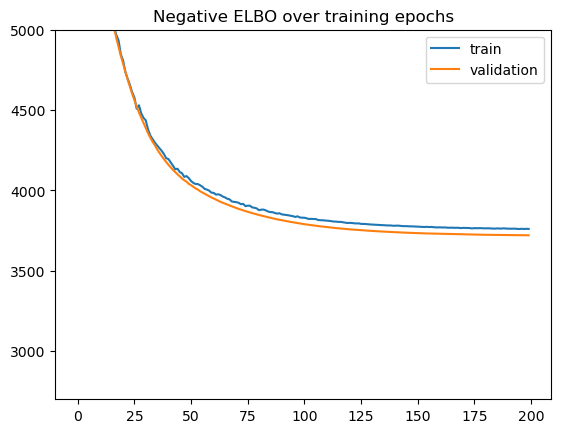

In [6]:
plt.plot(vae_ref.history["elbo_train"], label="train")
plt.plot(vae_ref.history["elbo_validation"], label="validation")
plt.title("Negative ELBO over training epochs")
plt.ylim(2700,5000)
plt.legend();

In [ ]:
#Can't run

adata_ref.obsm["X_totalvi_scarches"] = vae_ref.get_latent_representation()

In [7]:
#Can't run

X = adata_ref.obsm["X_totalvi_scarches"]
trans = umap.UMAP(
    n_neighbors=10,
    random_state=42,
    min_dist=0.4,
)
adata_ref.obsm["X_umap"] = trans.fit_transform(X)

vae_ref.umap_op_ = trans

KeyError: 'X_totalvi_scarches'

In [7]:
sc.pl.umap(
    adata_ref,
    color=['cell_lineage', "batch"],
    frameon=False,
    ncols=1,
)

KeyError: 'Could not find key cell_lineage in .var_names or .obs.columns.'

<Figure size 727.8x960 with 0 Axes>

In [8]:
vae_q = scvi.model.TOTALVI.load('/Users/tiinatuononen/Desktop/Thesis', adata=adata_query)

INFO     File /Users/tiinatuononen/Desktop/Thesis/model.pt already downloaded                
INFO     Found batches with missing protein expression                                       
INFO     Computing empirical prior initialization for protein background.                    


In [9]:
vae_q.umap_op_ = trans

NameError: name 'trans' is not defined

In [190]:
adata_query.obsm["X_totalvi_scarches"] = vae_q.get_latent_representation(adata_query)

In [191]:
adata_query.obsm["X_umap_project"] = vae_q.umap_op_.transform(
    adata_query.obsm["X_totalvi_scarches"]
)

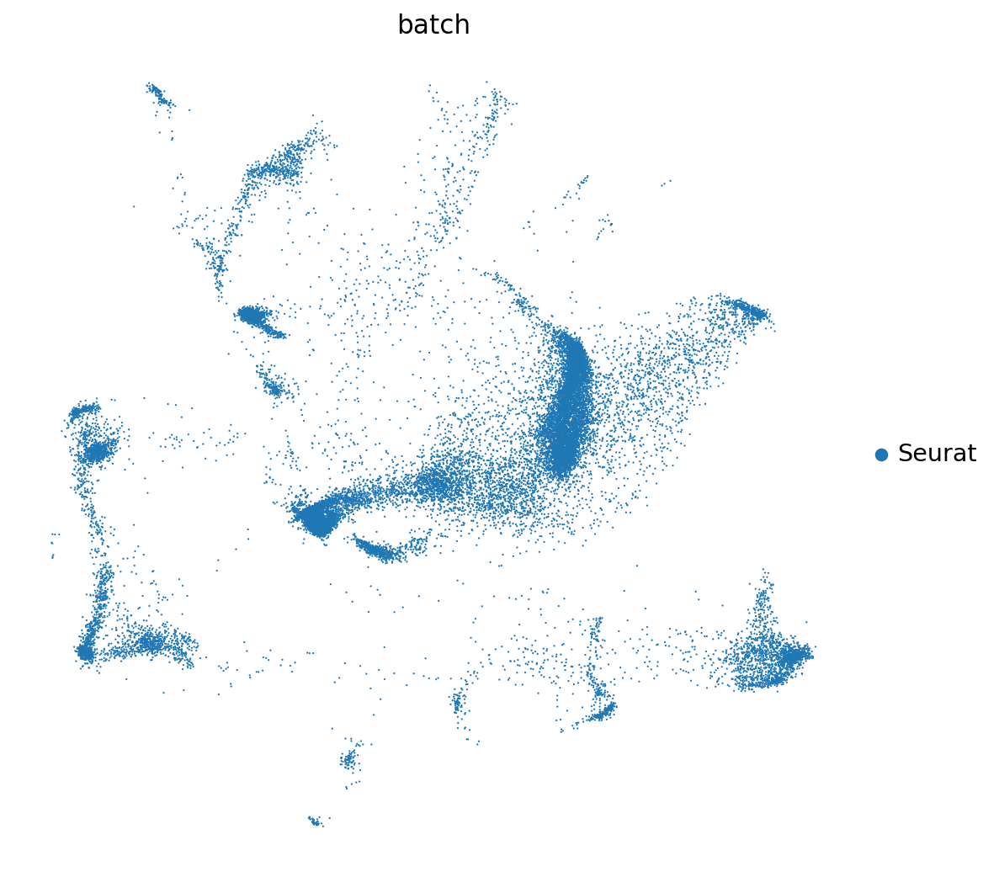

In [192]:
sc.pl.embedding(
    adata_query,
    "X_umap_project",
    color=["batch"],
    frameon=False,
    ncols=1,
)

In [193]:
adata_query.obs["cell_lineage"] = adata_query.shape[0] * [None]
umap_adata = sc.AnnData(np.concatenate([adata_query.obsm["X_umap_project"],
                                        adata_ref.obsm["X_umap"],], axis=0))
umap_adata.obs["cell_lineage"] = np.concatenate([adata_query.obs["cell_lineage"].values,
                                                 adata_ref.obs["cell_lineage"].values])
umap_adata.obs["batch"] = np.concatenate([adata_query.obs["batch"].values,
                                                 adata_ref.obs["batch"].values])
umap_adata.obs["dataset"] = np.concatenate([adata_query.shape[0] * ["query"],
                                            adata_ref.shape[0] * ["reference"]])
umap_adata.obsm["X_umap"] = umap_adata.X

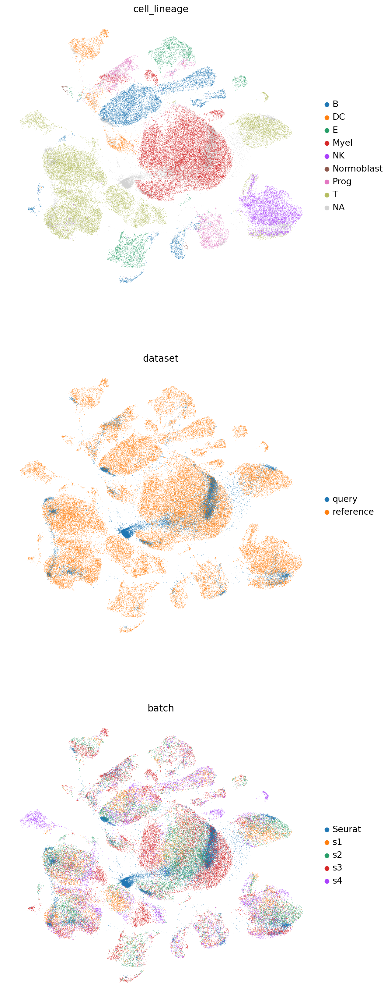

In [194]:
#inds = np.random.permutation(np.arange(umap_adata.shape[0]))
sc.pl.umap(
    umap_adata, #[inds],
    color=["cell_lineage", "dataset", "batch"],
    frameon=False,
    ncols=1,
)


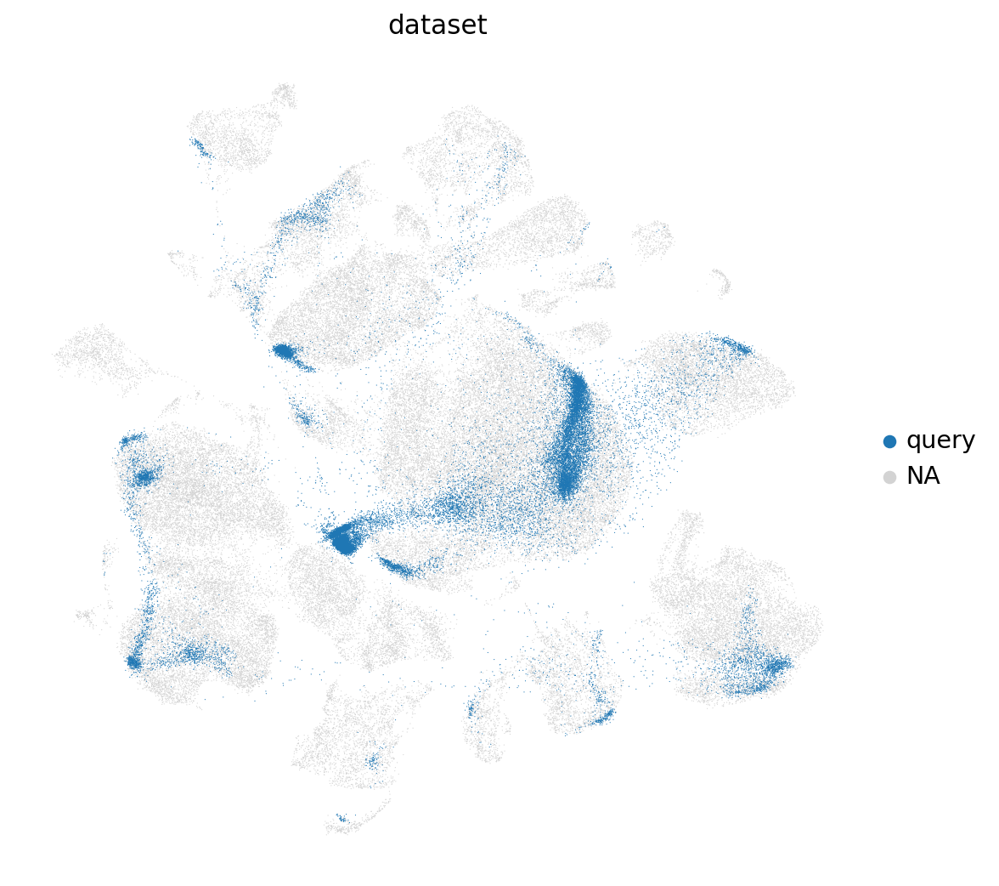

In [195]:
#inds = np.random.permutation(np.arange(umap_adata.shape[0]))
sc.pl.umap(
    umap_adata,#[inds],
    groups=['query'],
    color=["dataset"],
    frameon=False,
    ncols=1,
)

In [10]:
held_out_proteins = adata_query.obsm["protein_expression"].copy()
adata_query.obsm["protein_expression"] = np.zeros_like(adata_query.obsm["protein_expression"])

In [ ]:
foreground_prob = vae_q.get_protein_foreground_probability(
    n_samples=25,
    return_mean=True)

Intel MKL FATAL ERROR: This system does not meet the minimum requirements for use of the Intel(R) Math Kernel Library.
The processor must support the Intel(R) Supplemental Streaming SIMD Extensions 3 (Intel(R) SSSE3) instructions.
The processor must support the Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) instructions.
The processor must support the Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.


In [198]:
#foreground_prob.to_csv('./data/healthy_query_protein_means.csv')

In [199]:
# cleaner protein names
#parsed_protein_names = [p.split("_")[0] for p in adata.obsm["protein_expression"].columns]
for i, p in enumerate(held_out_proteins.columns[held_out_proteins.sum() != 0]):
    adata_query.obs["{} imputed".format(p)] = foreground_prob[held_out_proteins.columns[held_out_proteins.sum() != 0]].iloc[:, i]
    adata_query.obs["{} observed".format(p)] = held_out_proteins[held_out_proteins.columns[held_out_proteins.sum() != 0]].iloc[:, i]

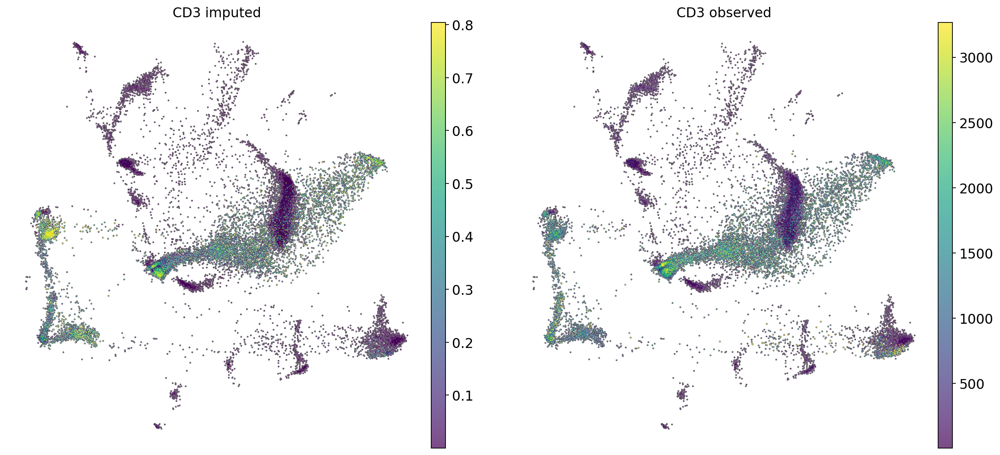

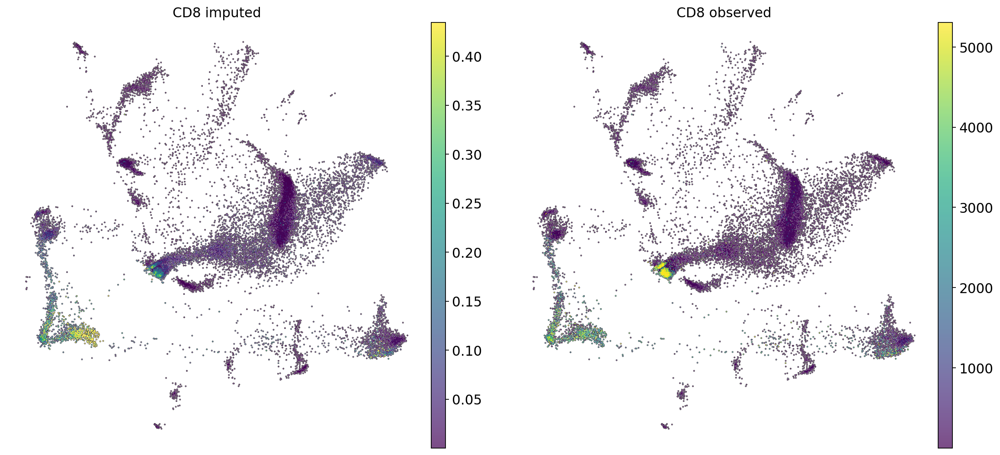

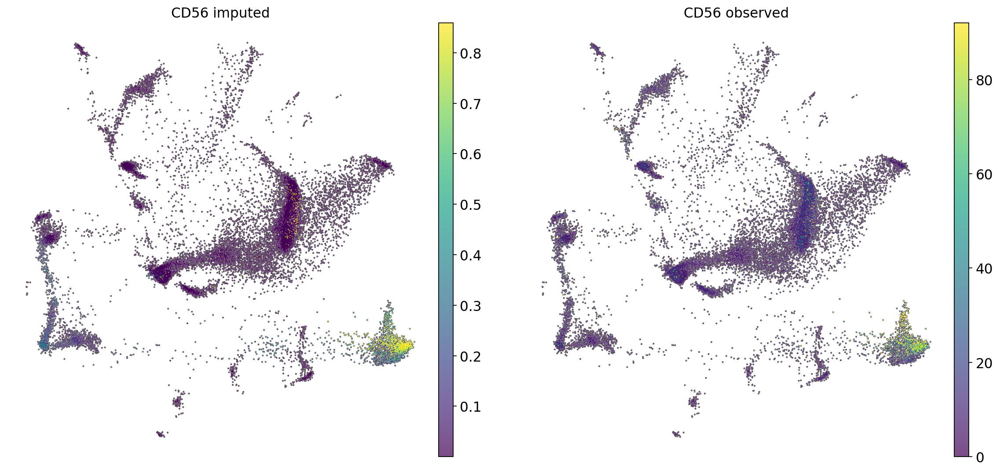

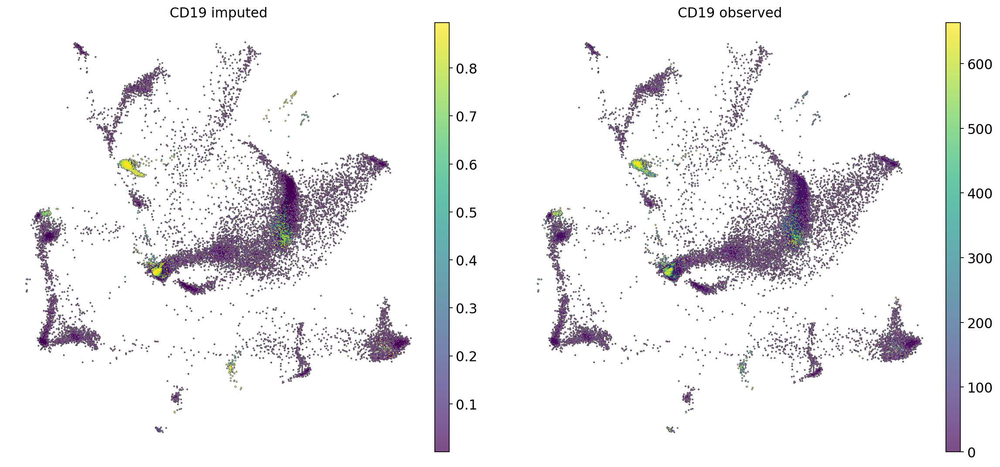

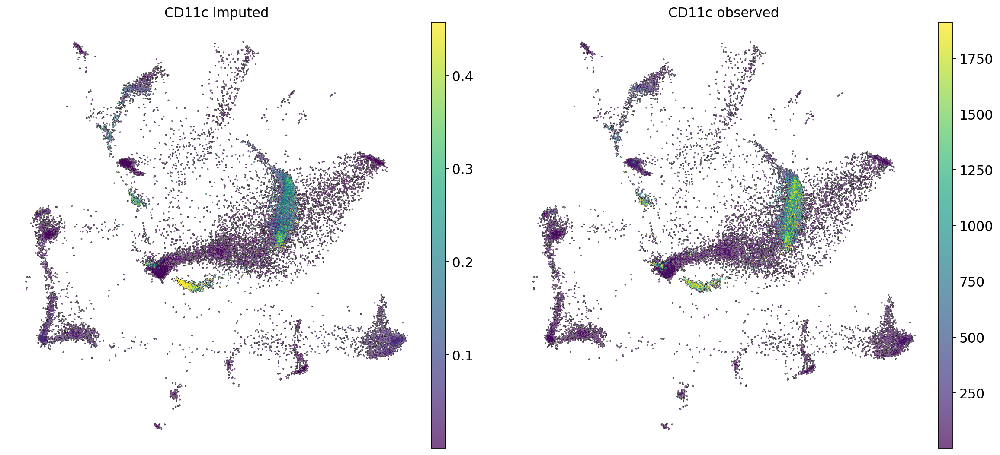

...

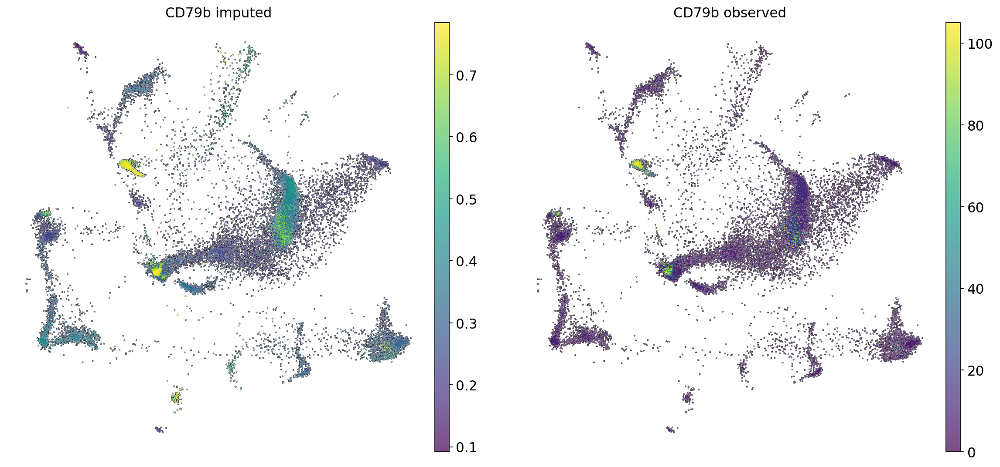

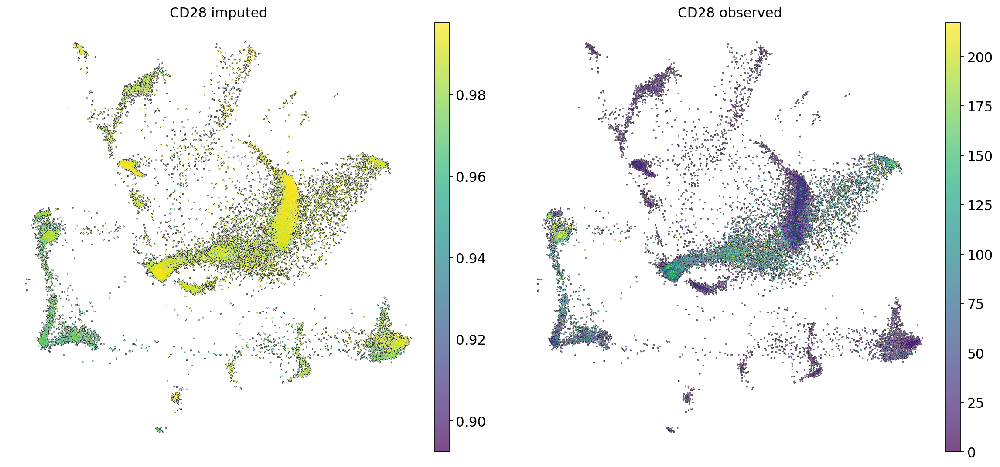

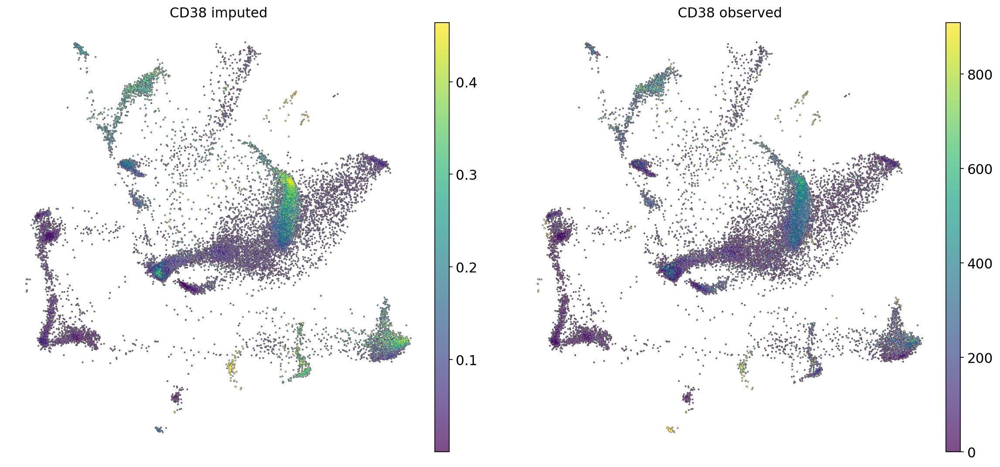

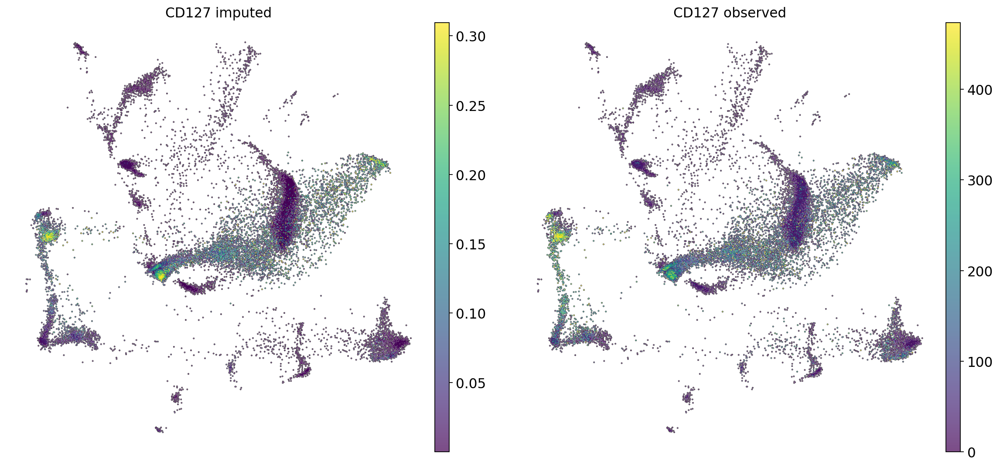

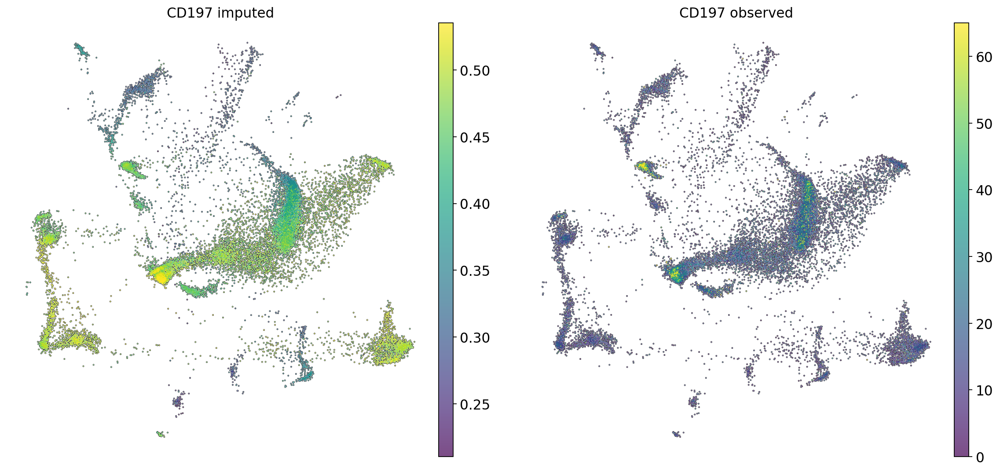

In [200]:
viz_keys = []
for p in held_out_proteins.columns[held_out_proteins.sum() != 0]:
    viz_keys.append(p + " imputed")
    viz_keys.append(p + " observed")
for i in list(range(2, 50, 2)):
    sc.pl.embedding(
        adata_query,
        "X_umap_project",
        color=viz_keys[i-2:i],
        vmax="p99",
        frameon=False,
        add_outline=True,
        wspace=0.1
        )